## Metric #1: Off-ice errors

**This notebook presents a full analysis of all 172 test pairs. For general intro and demo, see** `metric_off-ice-error.ipynb`.

### Analysis

#### 1. Basic information, importing modules

- Test area: **Kaskawulsh Glacier**
- Test packages: **CARST, Vmap, GIV, autoRIFT**
- Test pairs: 172 pairs in total; 43 pairs for each date range:
  - **Landsat 8 20180304-20180405**
  - **Landsat 8 20180812-20180818**
  - **Sentinel-2 20180304-20180314**
  - **Sentinel-2 20180508-20180627**

In [1]:
# Developer's setting
%load_ext autoreload
%autoreload 2

In [2]:
import gftt
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib import colors, cm
from matplotlib.colors import ListedColormap
import rasterio
from rasterio.plot import show
import numpy as np
import pandas as pd
import geopandas as gpd

#### 2. Load the feature tracking data list and off-ice area shapefile

Each row is a feature tracking test using a specific parameter combination described in each field.

In [3]:
df = pd.read_csv('../manifest_agu21.csv', dtype=str)
df

,Date,Chip (px),Resolution (px),Prefilter,Subpixel,Software,Vx,Vy
0,Sen2-20180304-20180314,48,12,Gau,16-node oversampling,CARST,/home/jovyan/Projects/PX_comparison/PX/CARST/2...,/home/jovyan/Projects/PX_comparison/PX/CARST/2...
1,Sen2-20180304-20180314,48,12,NAOF,16-node oversampling,CARST,/home/jovyan/Projects/PX_comparison/PX/CARST/2...,/home/jovyan/Projects/PX_comparison/PX/CARST/2...
2,Sen2-20180304-20180314,48,12,None,16-node oversampling,CARST,/home/jovyan/Projects/PX_comparison/PX/CARST/2...,/home/jovyan/Projects/PX_comparison/PX/CARST/2...
3,Sen2-20180304-20180314,48,1,Gau,16-node oversampling,CARST,/home/jovyan/Projects/PX_comparison/PX/CARST/2...,/home/jovyan/Projects/PX_comparison/PX/CARST/2...
4,Sen2-20180304-20180314,48,1,NAOF,16-node oversampling,CARST,/home/jovyan/Projects/PX_comparison/PX/CARST/2...,/home/jovyan/Projects/PX_comparison/PX/CARST/2...
...,...,...,...,...,...,...,...,...
167,Sen2-20180508-20180627,64,8,Gau,pyrUP,autoRIFT,/home/jovyan/Projects/PX_comparison/PX/autoRIF...,/home/jovyan/Projects/PX_comparison/PX/autoRIF...
168,Sen2-20180508-20180627,32,4,NAOF,pyrUP,autoRIFT,/home/jovyan/Projects/PX_comparison/PX/autoRIF...,/home/jovyan/Projects/PX_comparison/PX/autoRIF...
169,Sen2-20180508-20180627,32,8,NAOF,pyrUP,autoRIFT,/home/jovyan/Projects/PX_comparison/PX/autoRIF...,/home/jovyan/Projects/PX_comparison/PX/autoRIF...
170,Sen2-20180508-20180627,64,4,NAOF,pyrUP,autoRIFT,/home/jovyan/Projects/PX_comparison/PX/autoRIF...,/home/jovyan/Projects/PX_comparison/PX/autoRIF...


Load the off-ice area shapefile.

In [4]:
# off-ice area
in_shp = '../../data/shapefiles/bedrock_V1.shp'
off_ice = gpd.read_file(in_shp)
# in_shp2 = '/home/jovyan/Projects/PX_comparison/Bedrock_shp/Kaskawulsh_RGI60_EPSG32607.shp'
# off_ice2 = gpd.read_file(in_shp2)

#### 3. Create a colormap for glacier speed

Now make a special `viridis` colormap designed for Kaskawulsh:

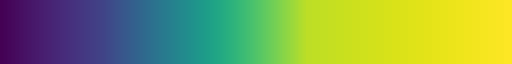

In [5]:
viridis = cm.get_cmap('viridis', 256)
newcolors1 = viridis(np.linspace(0, 0.2, 128))
newcolors2 = viridis(np.linspace(0.2, 0.9, 256))
newcolors3 = viridis(np.linspace(0.9, 1, 256))
newcolors = np.vstack((newcolors1, newcolors2, newcolors3))
cmap = ListedColormap(newcolors)
cmap.set_over(np.array([202,0,32,128]) / 255)
cmap.set_under(np.array([0,0,0,128]) / 255)
cmap

The velocity x component looks like this:

#### 4. Off-ice error for all 172 tests

**Vx and Vy:**

In [16]:
def plot_datestr_batch(demo, cmap, kind='Vx'):
    fig, ax1 = plt.subplots(8, 6, figsize=(20, 21))
    
    n = 0

    for idx, row in demo.iterrows():
        label = '-'.join((row.Software, row['Chip (px)'], row['Resolution (px)'], row.Prefilter)) + '\n' + row.Subpixel
        ax_sel = ax1[n // 6, n % 6]
        
        if kind == 'Vx':
            target = row.Vx
        elif kind == 'Vy':
            target = row.Vy
        else:
            raise ValueError('`kind` only accepts Vx or Vy')

        with rasterio.open(target) as vx_src:
            show(vx_src, ax=ax_sel, vmin=-0.5, vmax=2, cmap=cmap)
        ax_sel.set_title(label)
        ax_sel.xaxis.set_ticklabels([])
        ax_sel.yaxis.set_ticklabels([])

        n += 1
        
    for i in range(n, 48):
        ax_sel = ax1[i // 6, i % 6]
        fig.delaxes(ax_sel)
    
    plt.tight_layout()
    fig.patch.set_facecolor('xkcd:white')
    return fig, ax1

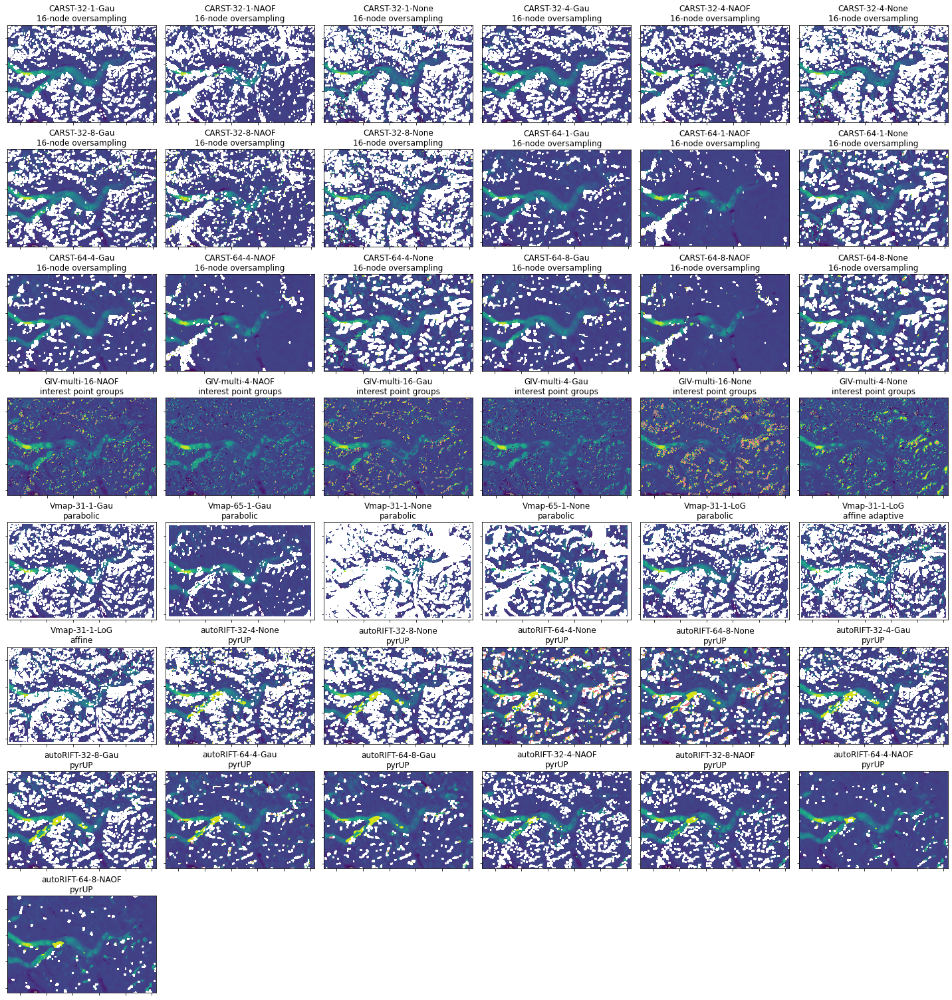

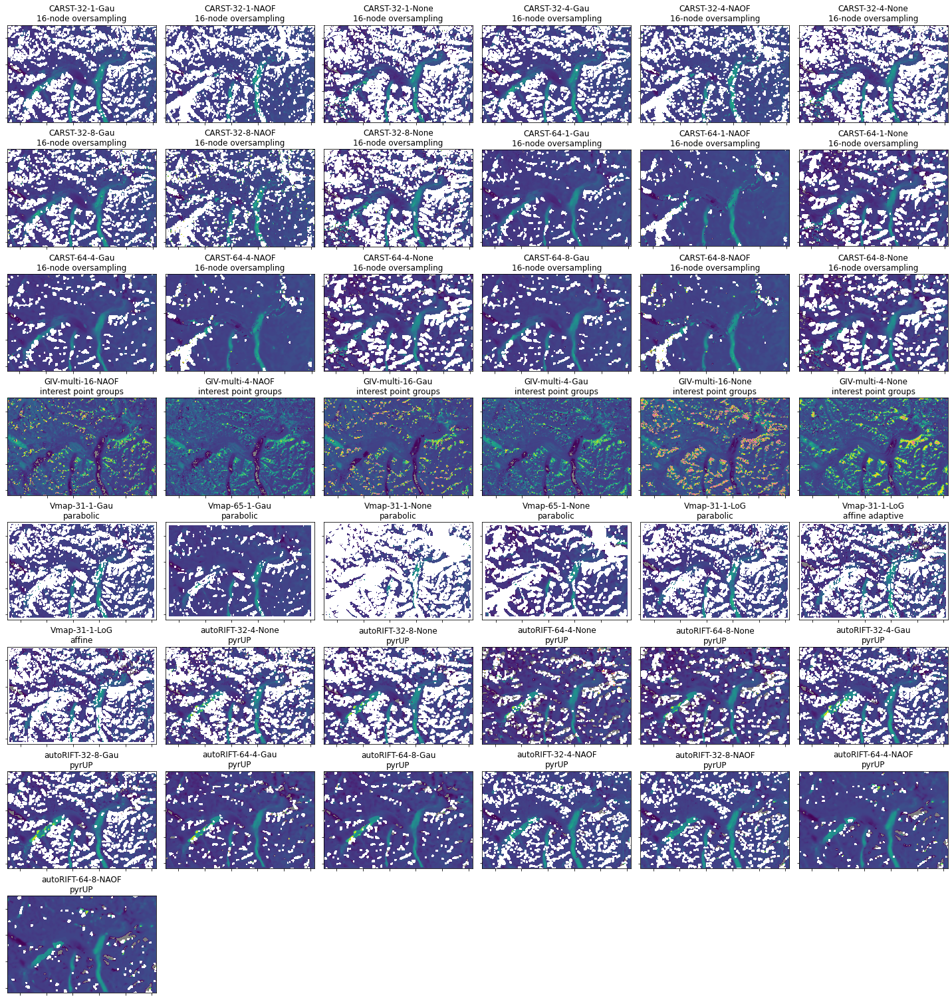

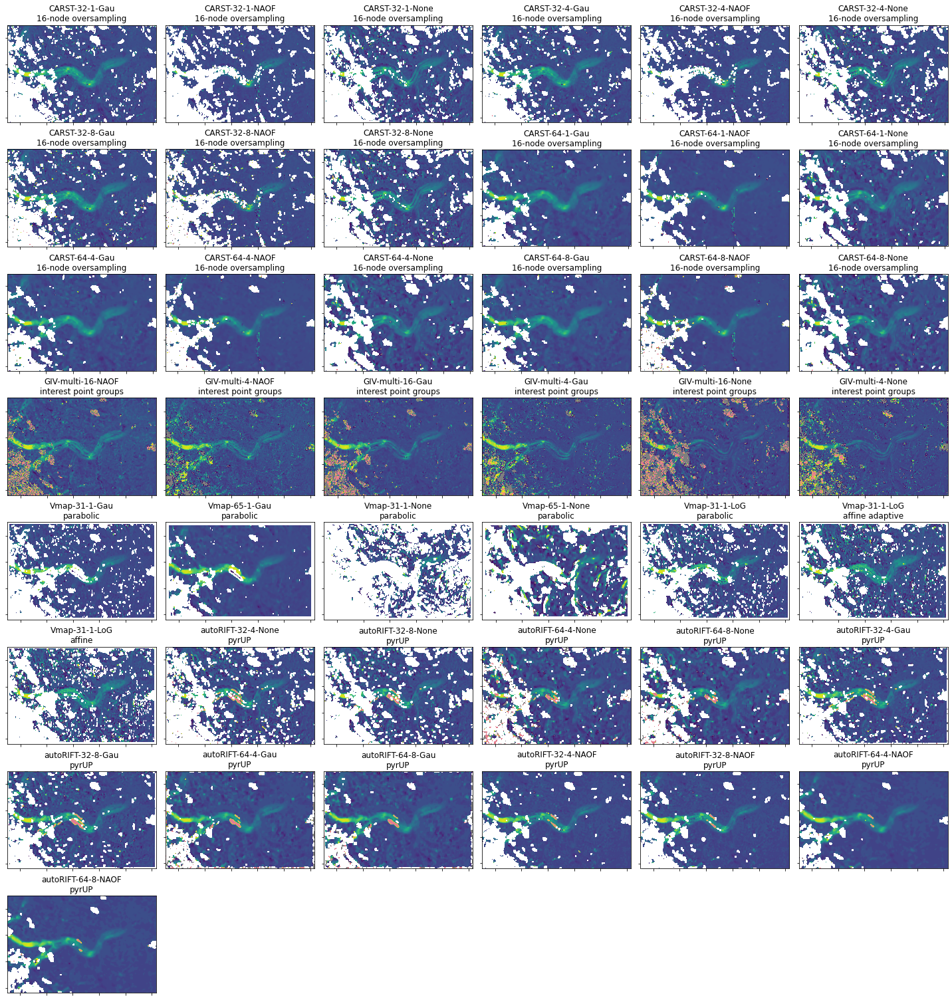

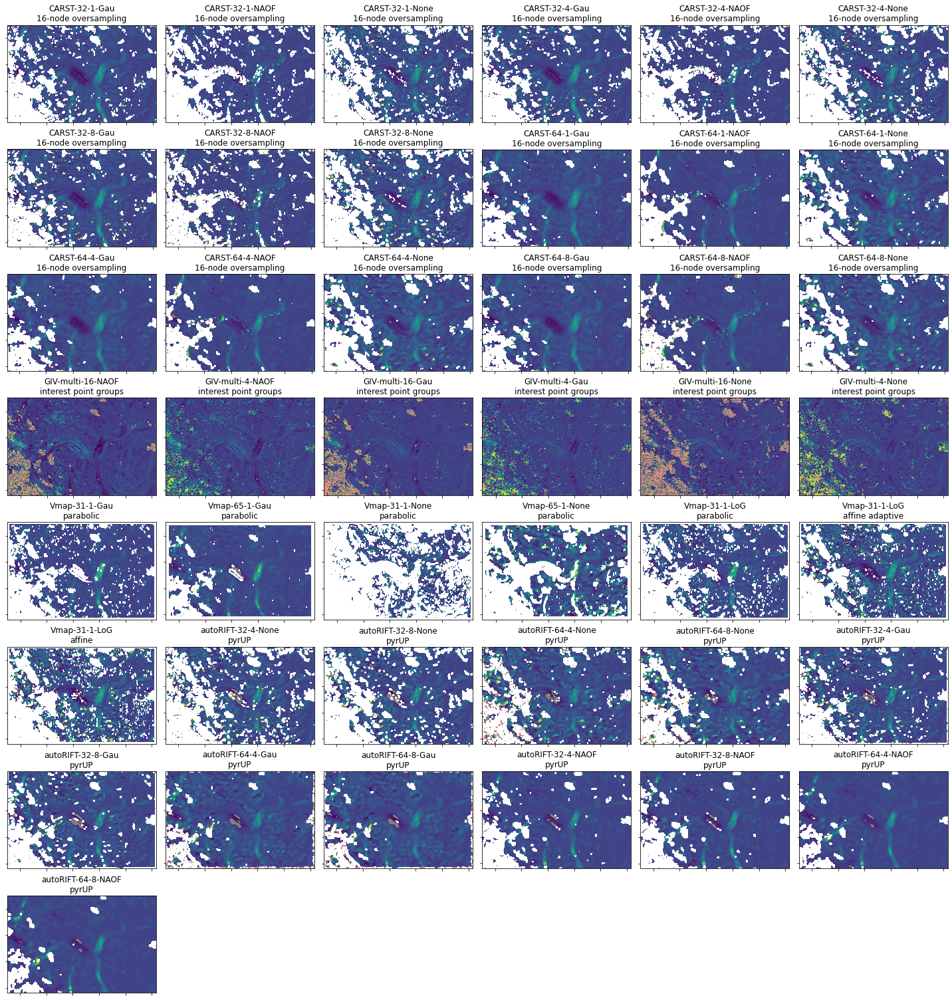

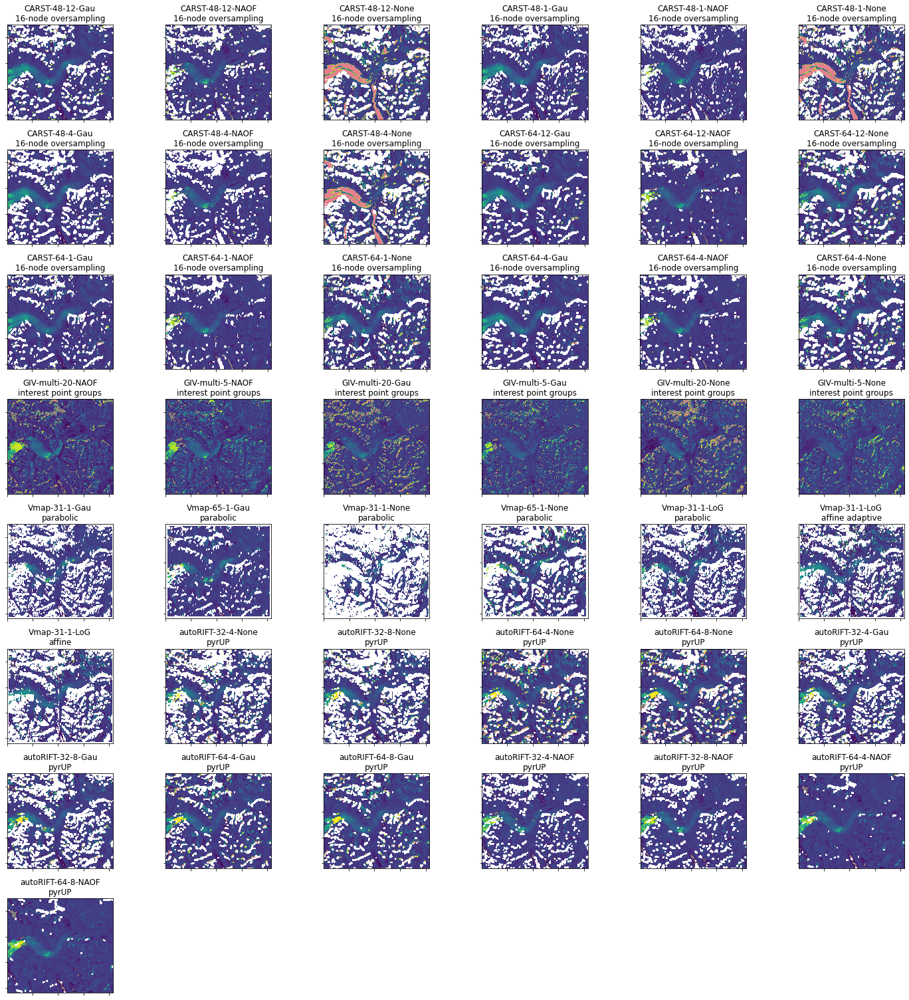

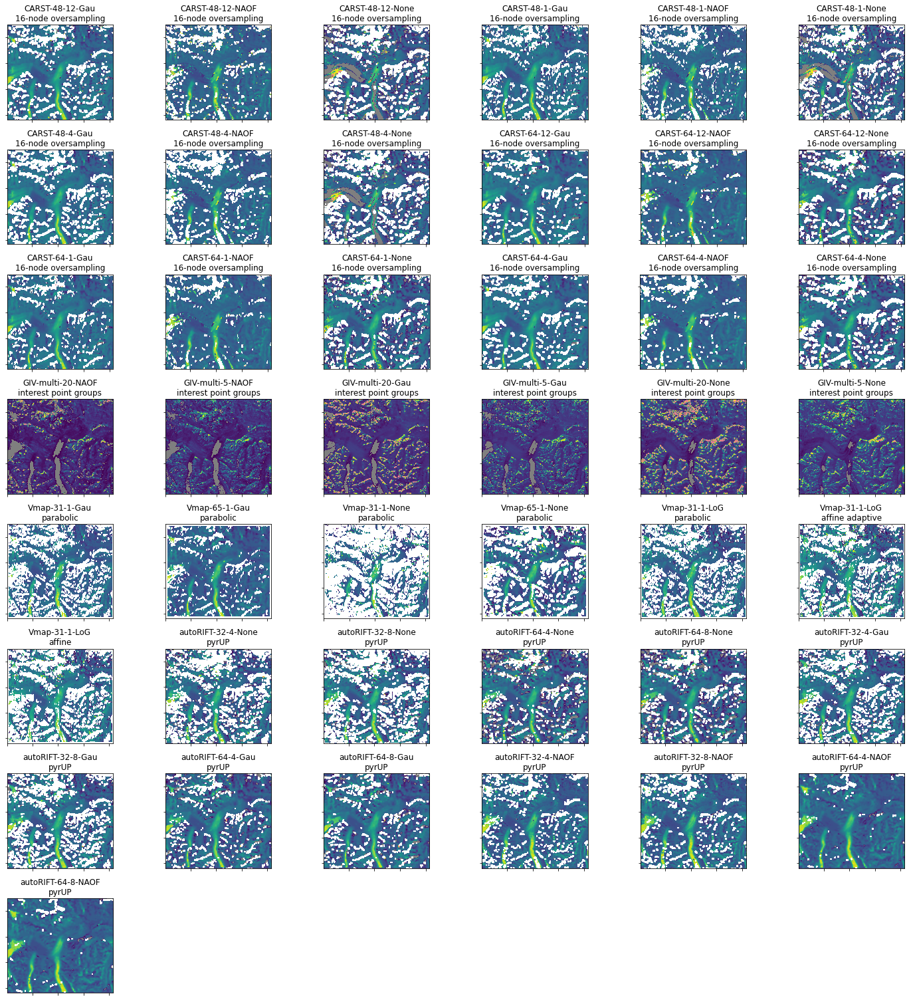

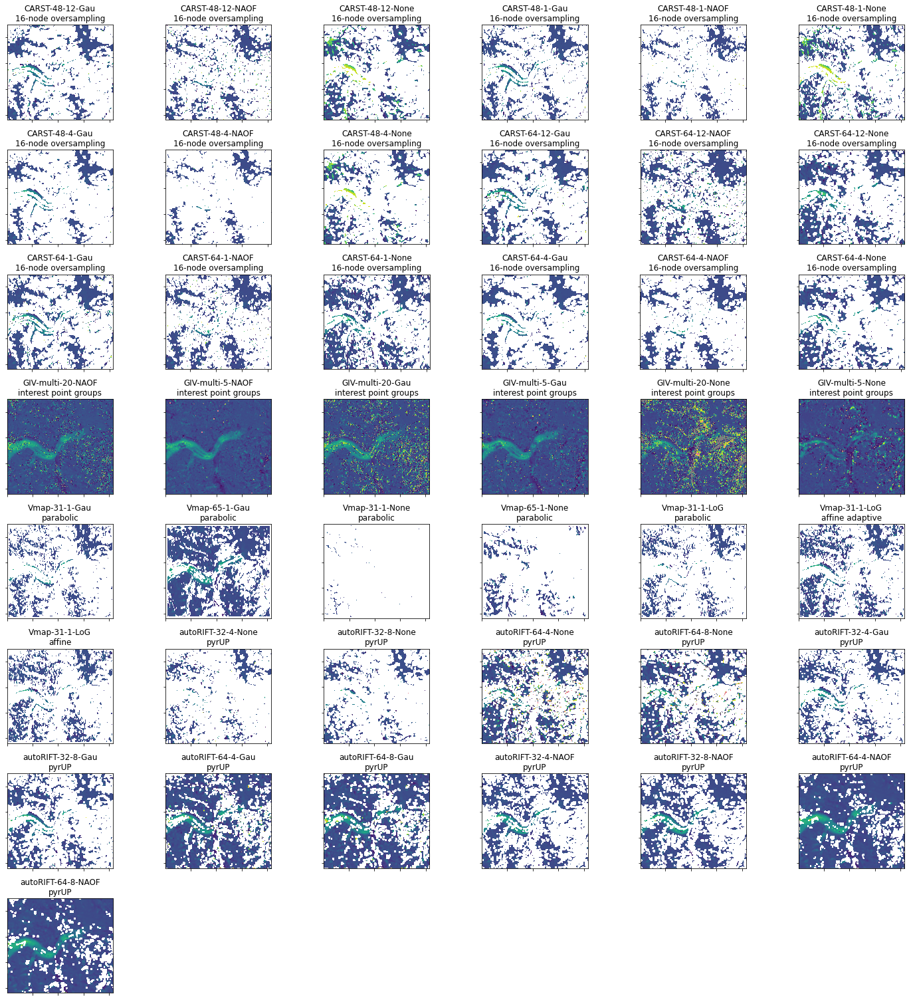

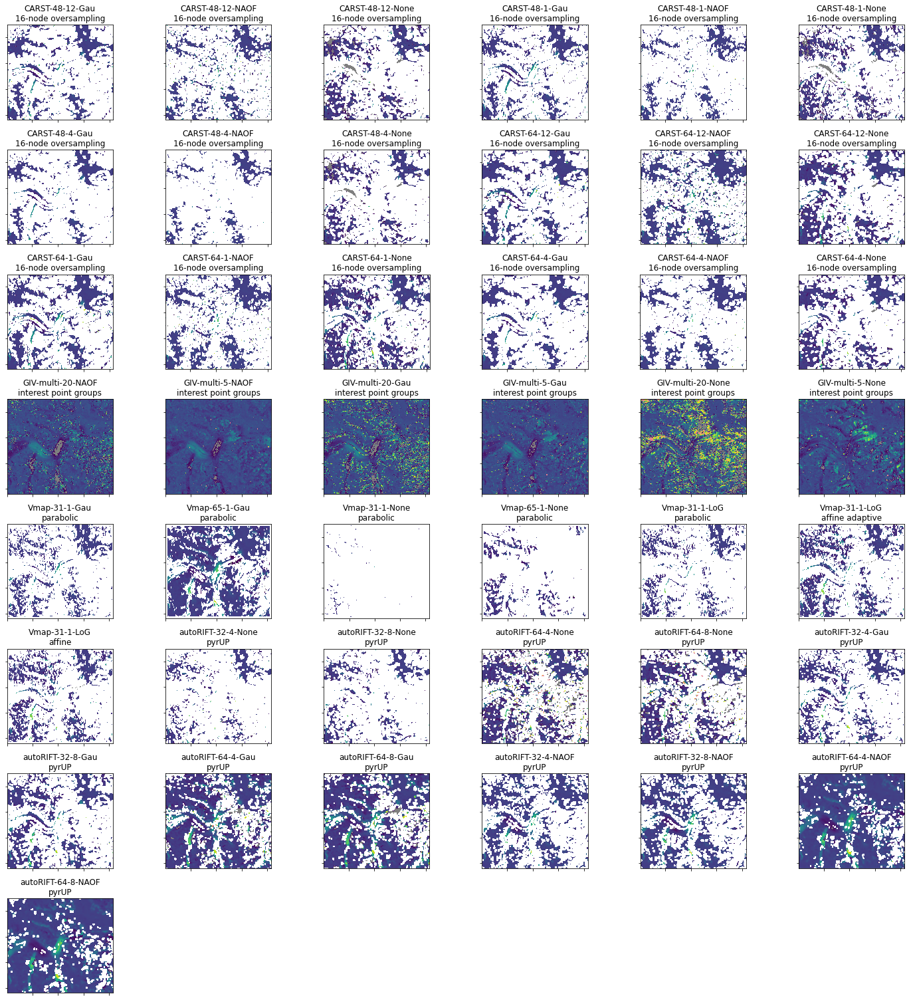

In [17]:
for datestr in ['LS8-20180304-20180405', 'LS8-20180802-20180818', 'Sen2-20180304-20180314', 'Sen2-20180508-20180627']:
    for kind in ['Vx', 'Vy']:
       
        demo = df.loc[df['Date'] == datestr]
        fig, _ = plot_datestr_batch(demo, cmap, kind=kind)
        fig.savefig('figs/' + datestr + '-' + kind + '.png')

**Off-ice error**:

In [26]:
def plot_oie_batch(demo, cmap, df):

    fig, ax2 = plt.subplots(8, 6, figsize=(20, 28))

    n = 0

    for idx, row in demo.iterrows():
        label = '-'.join((row.Software, row['Chip (px)'], row['Resolution (px)'], row.Prefilter)) + '\n' + row.Subpixel
        ax_sel = ax2[n // 6, n % 6]
        ax_sel.axis('equal')

        if row.Software == 'GIV':
            vx, vy, z, thres_idx = gftt.off_ice_errors(vxfile=row.Vx, vyfile=row.Vy, wfile=row.Vx.replace('u_', 'pkr_'), off_ice_area=in_shp, max_n=10000, plot=True, ax=ax_sel)
        else:
            vx, vy, z, thres_idx = gftt.off_ice_errors(vxfile=row.Vx, vyfile=row.Vy, off_ice_area=in_shp, max_n=10000, plot=True, ax=ax_sel)
        ax_sel.set_xlim(-1.5, 1.5)
        ax_sel.set_ylim(-1.5, 1.5)

        rect = patches.Rectangle((min(vx[thres_idx]), min(vy[thres_idx])), max(vx[thres_idx]) - min(vx[thres_idx]), max(vy[thres_idx]) - min(vy[thres_idx]), 
                                  linewidth=1, edgecolor='r', facecolor='none')
        ax_sel.add_patch(rect)
        
        oie_x = 0.5 * (max(vx[thres_idx]) - min(vx[thres_idx]))
        oie_y = 0.5 * (max(vy[thres_idx]) - min(vy[thres_idx]))

        df.loc[idx, 'OIE-x'] = oie_x
        df.loc[idx, 'OIE-y'] = oie_y
        label += '\n $e_x$ = {:6.3f} | $e_y$ = {:6.3f} (m/day)'.format(oie_x, oie_y)
        ax_sel.set_title(label)

        n += 1

        
    for i in range(n, 48):
        ax_sel = ax2[i // 6, i % 6]
        fig.delaxes(ax_sel)
        
    plt.tight_layout()
    fig.patch.set_facecolor('xkcd:white')
    return fig, ax2, df

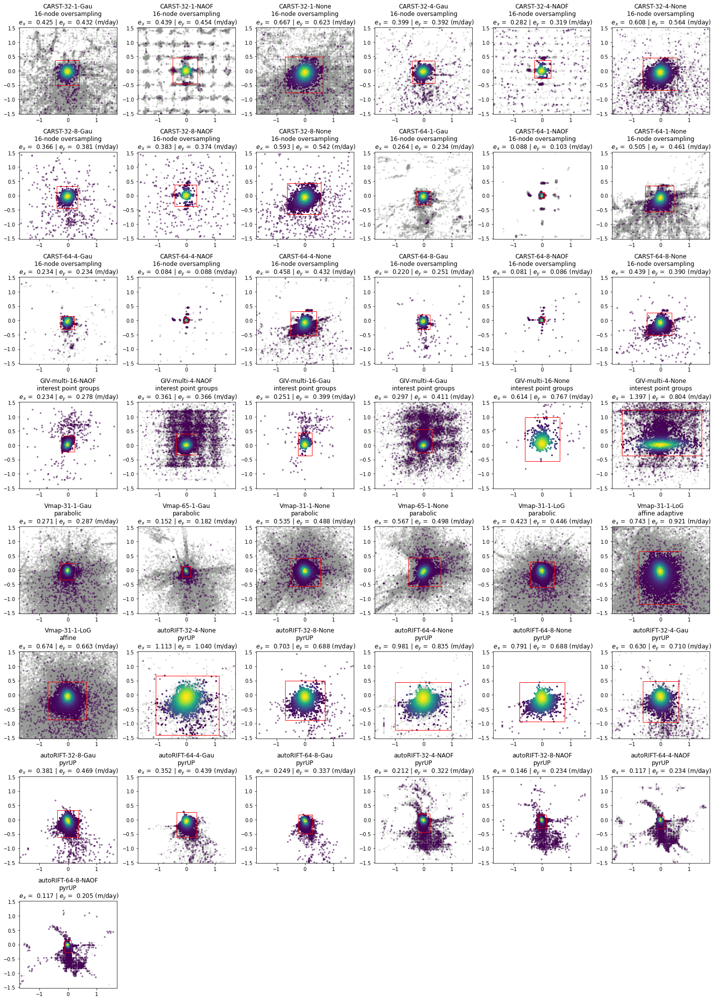

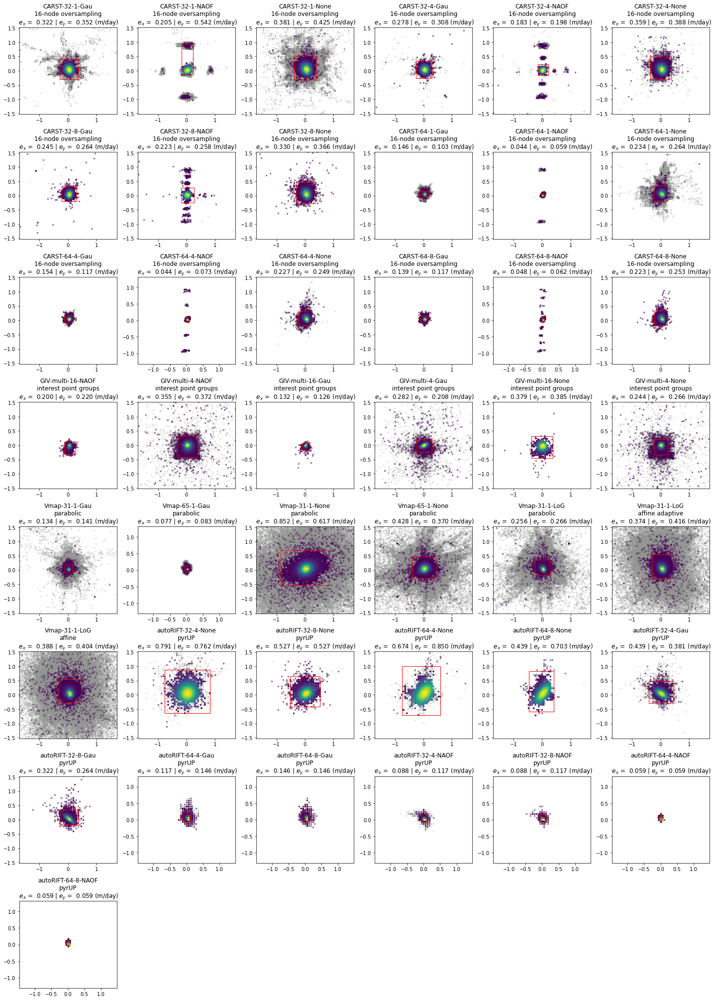

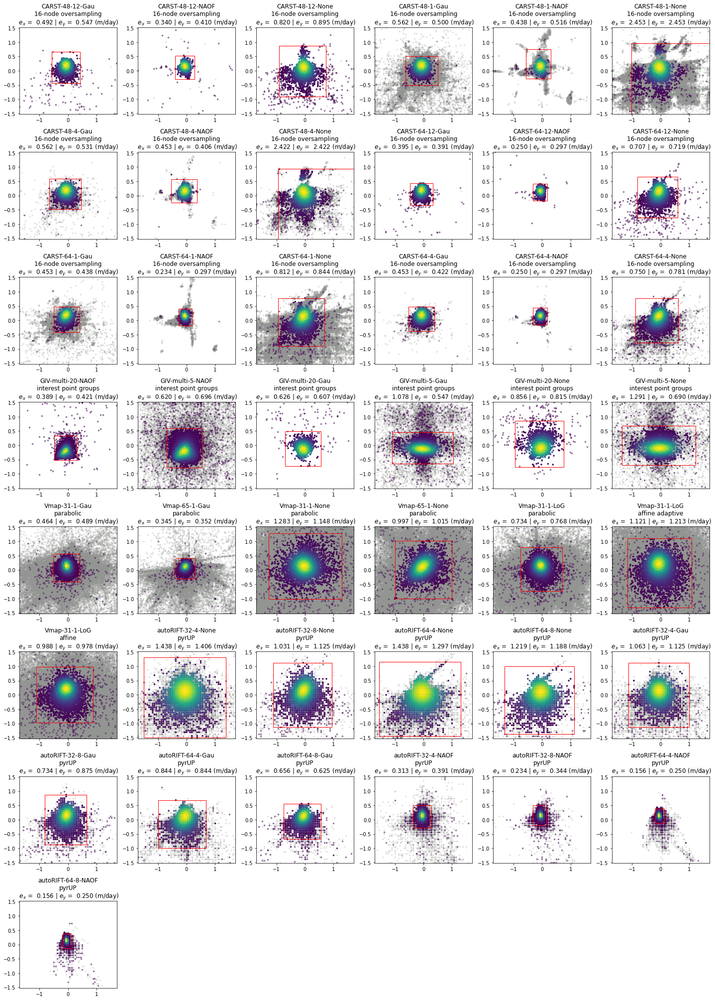

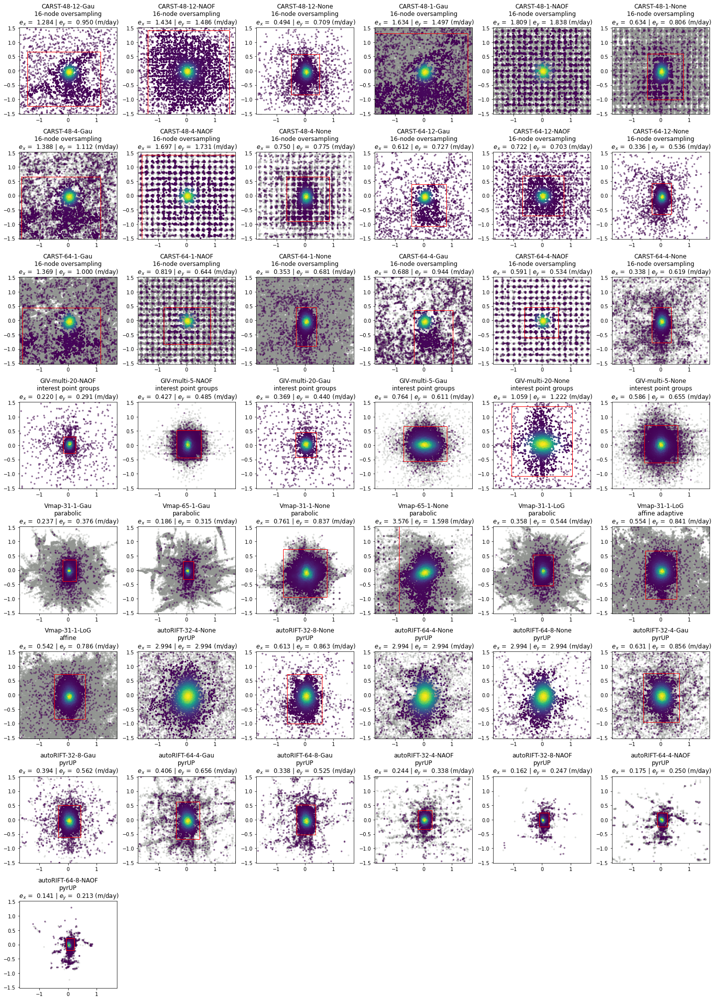

In [27]:
for datestr in ['LS8-20180304-20180405', 'LS8-20180802-20180818', 'Sen2-20180304-20180314', 'Sen2-20180508-20180627']:
    demo = df.loc[df['Date'] == datestr]
    fig, _, df = plot_oie_batch(demo, cmap, df)
    fig.savefig('figs/' + datestr + '-OIE.png')

Save the quantitative results (`OIE-x` and `OIE-y`):

In [28]:
df.to_csv('../results_2022.csv', index=False)
# df